## Jordi Blasco Lozano  
### Visualización de Imágenes y Keypoints – Parte 2

- #### Librerías y Configuración Inicial

    En este bloque se importan las librerías necesarias para la visualización.

    También se importa el módulo **DataLoader** para cargar nuestro dataset de paths.

In [1]:

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import scipy.io as sio
import pandas as pd

# Importar DataLoader del proyecto.
from archivos.dataloader import DataLoader

- #### Carga del Dataset

    A continuación, se instancia la clase **DataLoader** para cargar los datos.
    El DataFrame resultante contiene todas las rutas de las imágenes y los archivos que contienen los keypoints, permitiendo acceder a la información de cada categoría. Nos guardamos en este caso también las categorias para mostrarlas en los titulos de los plots

In [2]:
# Instanciar el DataLoader y cargar los dataframes
dl = DataLoader()
dlf = dl.load_data()


- #### Redimensionamiento de Imágenes y Ajuste de Keypoints y Plotteo de Imagenes con su Grafo y Aristas Calculadas


In [3]:
# Tamaño objetivo para redimensionar las imágenes
obj_resize = (256, 256)

def load_img_and_keypoints_from_row(row):
    """
    Carga la imagen y sus keypoints a partir de una fila del dataframe.
    """
    img_path = row['img']
    mat_path = row['mat']
    
    # Cargar la imagen
    img = Image.open(img_path)
    # Cargar el archivo .mat que contiene los keypoints
    mat_data = sio.loadmat(mat_path)
    kpts = np.array(mat_data['pts_coord']) 
    
    # Determinar el tamaño original de la imagen
    orig_size = img.size  # (ancho, alto)
    
    # Escalar los keypoints al nuevo tamaño
    kpts[0] = kpts[0] * obj_resize[0] / orig_size[0]
    kpts[1] = kpts[1] * obj_resize[1] / orig_size[1]
    
    # Redimensionar la imagen
    img_resized = img.resize(obj_resize, resample=Image.BILINEAR)
    
    return img_resized, kpts

def plot_image_with_graph(ax, img, kpts, edges, title=""):
    """
    Dibuja en el eje indicado la imagen con keypoints y el grafo sobrepuesto.
    
    Parámetros:
        - ax: objeto matplotlib.axes donde se dibuja.
        - img: imagen a mostrar.
        - kpts: array de keypoints (2, N).
        - edges: lista de tuplas (i, j) con las conexiones del grafo.
        - title: título para la subfigura.
    """
    ax.imshow(img)
    ax.scatter(kpts[0], kpts[1], c='w', edgecolors='k')
    for i, j in edges:
        ax.plot([kpts[0, i], kpts[0, j]], [kpts[1, i], kpts[1, j]], 'r-')
    ax.set_title(title)
    ax.axis('off')

- #### Construcción del Grafo usando Delaunay Triangulation 

    Para conectar puntos formando triángulos de manera uniforme podemos usar la **`Delaunay Triangulation`**. La idea principal de la triangulación de Delaunay es la siguiente:

1. **Conectar los puntos para formar triángulos:** Se prueban todas las posibles combinaciones de 3 puntos para ver si pueden formar un triángulo.

2. **Dibujar el círculo que pasa por los 3 vértices:** A cada triángulo se le puede dibujar un círculo (llamado "círculo circunscrito") que toque exactamente sus 3 vértices.

3. **Verificar la propiedad del círculo vacío:** La clave es asegurarse de que, para cada triángulo, no exista ningún otro punto dentro de ese círculo. Si hay algún punto dentro, ese triángulo no cumple la condición de Delaunay y se descarta.

4. **Formar el grafo:** Una vez que se han identificado todos los triángulos “válidos” (aquellos cuyo círculo circunscrito está vacío), se extraen las aristas únicas de estos triángulos para crear un grafo que conecta los puntos.

`pd: he decidido no usar la implementación de la triangulacion con la librería de Delaunay para entender de forma más interna que es lo que hacia la función *Delaunay()*`


In [4]:
def delaunay_graph(kpts):
    """
    Construye un grafo usando Delaunay triangulation.
    
    Parámetros:
        - kpts: np.array de shape (2, N) con las coordenadas de los keypoints.
          ejemplo: kpts = np.array([[x1, x2, ..., xN], [y1, y2, ..., yN]])
    
    Devuelve:
        - edges: Lista de tuplas (i, j) representando las aristas del grafo. ej: [(0, 1), (1, 2), ...]
    """
    pts = kpts.T  # Convertir a shape (N, 2)
    tri = Delaunay(pts)
    
    edges = set()
    # Recorrer cada triángulo y extraer sus aristas
    for simplex in tri.simplices:
        for i in range(3):
            for j in range(i + 1, 3):
                edge = tuple(sorted((simplex[i], simplex[j])))
                edges.add(edge)
    
    return list(edges)

- #### Construcción del Grafo usando k-Nearest Neighbors (k-NN)

Esta función `knn_graph()` conecta cada punto con sus k vecinos más cercanos de la siguiente forma:

1. **Calcular las distancias:**  
   Para cada punto, se calcula la distancia a todos los otros puntos del conjunto.

2. **Exclusión del mismo punto:**  
   Se ignora la distancia del punto consigo mismo (se marca como infinito).

3. **Seleccionar los k vecinos más cercanos:**  
   Se ordenan las distancias y se eligen los índices de los k puntos más cercanos.

4. **Formar las aristas del grafo:**  
   Se crean conexiones (aristas) entre el punto actual y cada uno de sus vecinos, asegurando que la conexión sea única.


In [7]:
def delaunay_graph(kpts):
    """
    Construye un grafo usando Delaunay triangulation.
    
    Parámetros:
        - kpts: np.array de shape (2, N) con las coordenadas de los keypoints.
          ejemplo: kpts = np.array([[x1, x2, ..., xN], [y1, y2, ..., yN]])
    
    Devuelve:
        - edges: Lista de tuplas (i, j) representando las aristas del grafo. ej: [(0, 1), (1, 2), ...]
    """
    pts = kpts.T  # Convertir a shape (N, 2)
    
    # Realizar la triangulación de Delaunay
    from scipy.spatial import Delaunay
    tri = Delaunay(pts)
    
    edges = set()
    # Recorrer cada triángulo y extraer sus aristas
    for simplex in tri.simplices:
        for i in range(3):
            for j in range(i + 1, 3):
                edge = tuple(sorted((simplex[i], simplex[j])))
                edges.add(edge)
    
    return list(edges)

- #### Ejercicios

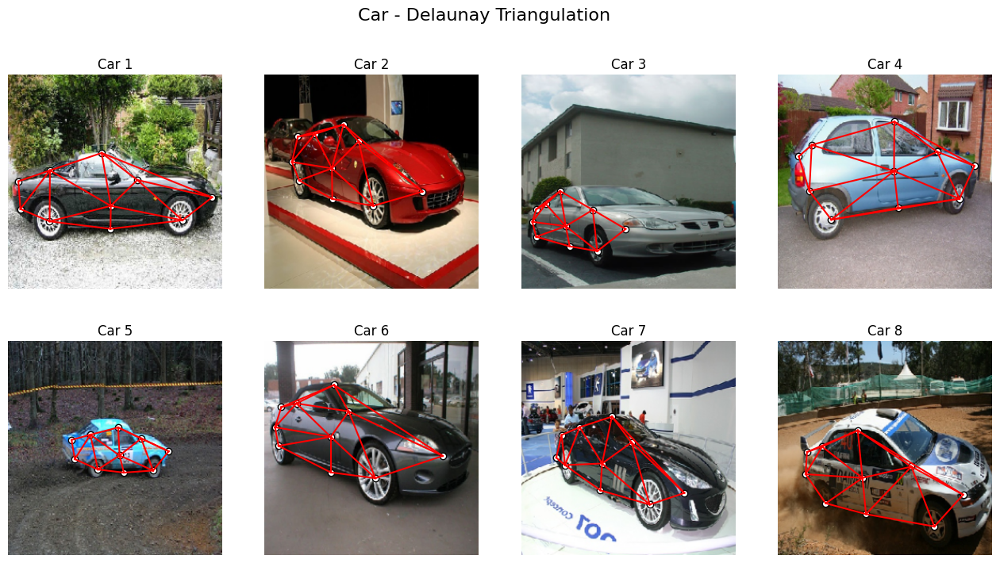

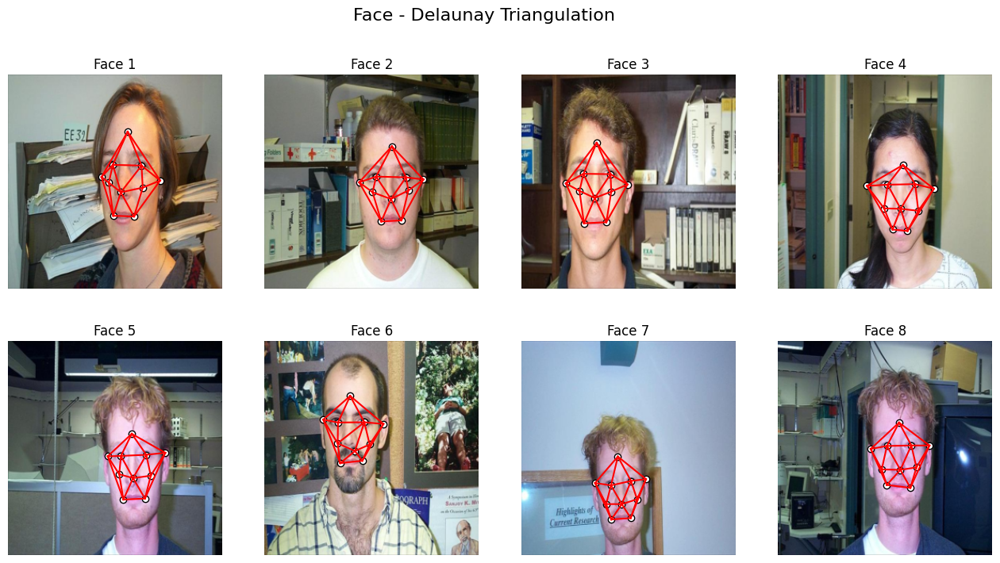

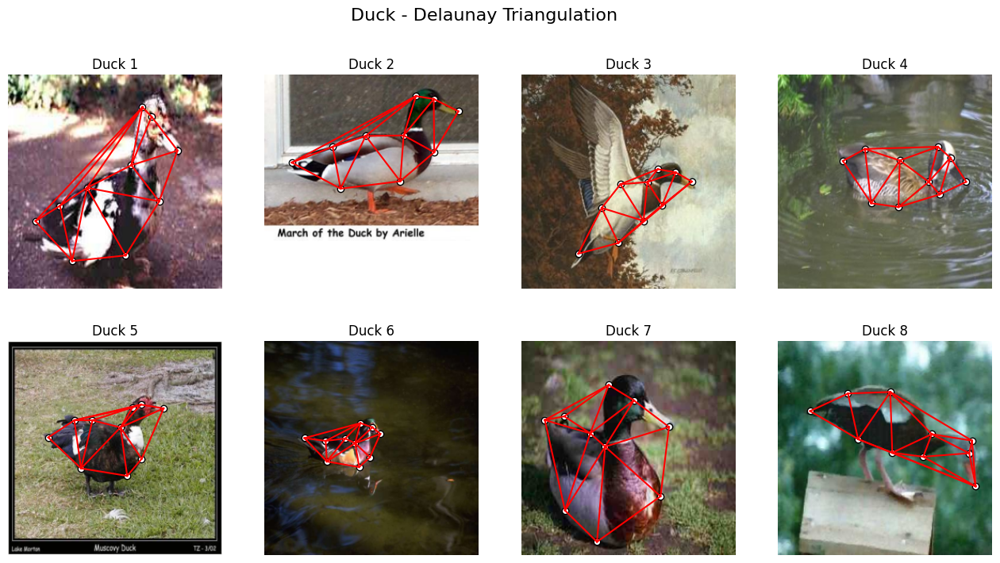

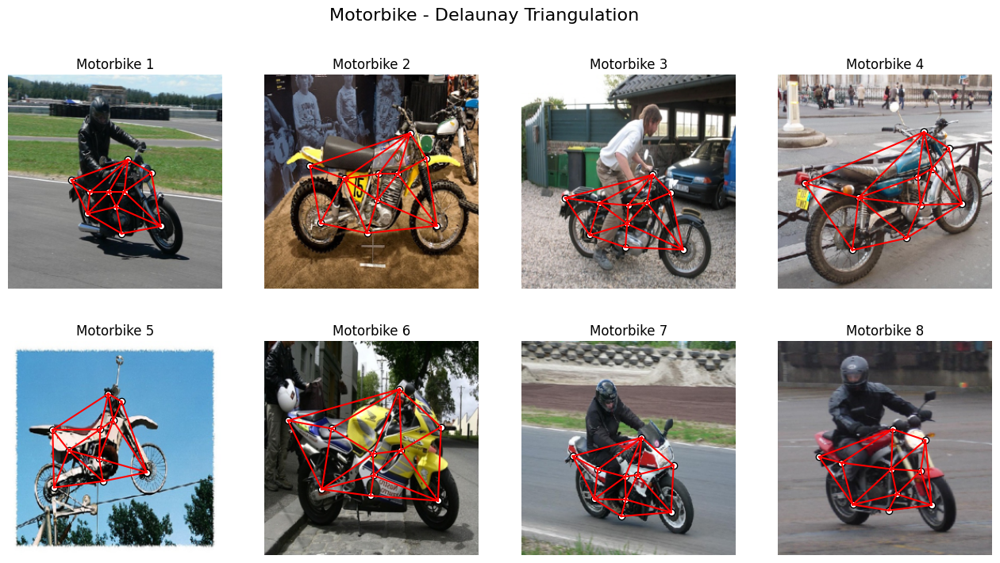

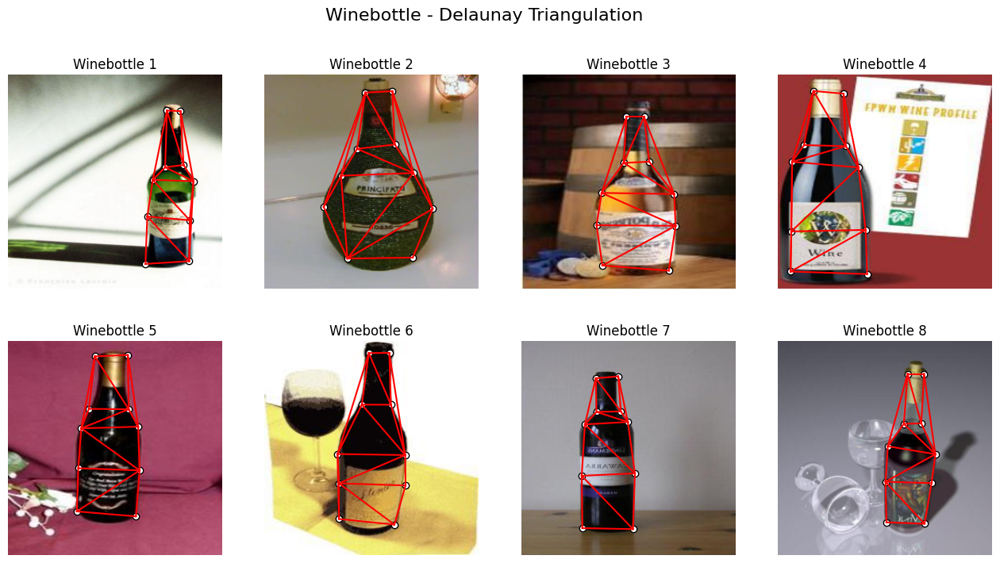

In [8]:
# Ejercicio 1: Delaunay Triangulation
# Para cada categoría se seleccionan 8 imágenes y se muestran en un grid 2x4.

for cat_name, cat_df in dlf.items():

    # seleccion 8 imágenes
    sample_rows = cat_df.sample(8) 
    
    # Crear grid 2x4
    fig, axs = plt.subplots(2, 4, figsize=(16, 8))
    axs = axs.flatten()
    
    for i, (_, row) in enumerate(sample_rows.iterrows()):
        img, kpts = load_img_and_keypoints_from_row(row)
        edges = delaunay_graph(kpts)
        plot_image_with_graph(axs[i], img, kpts, edges, title=f"{cat_name.capitalize()} {i+1}")
    
    fig.suptitle(f"{cat_name.capitalize()} - Delaunay Triangulation", fontsize=16)
    plt.show()

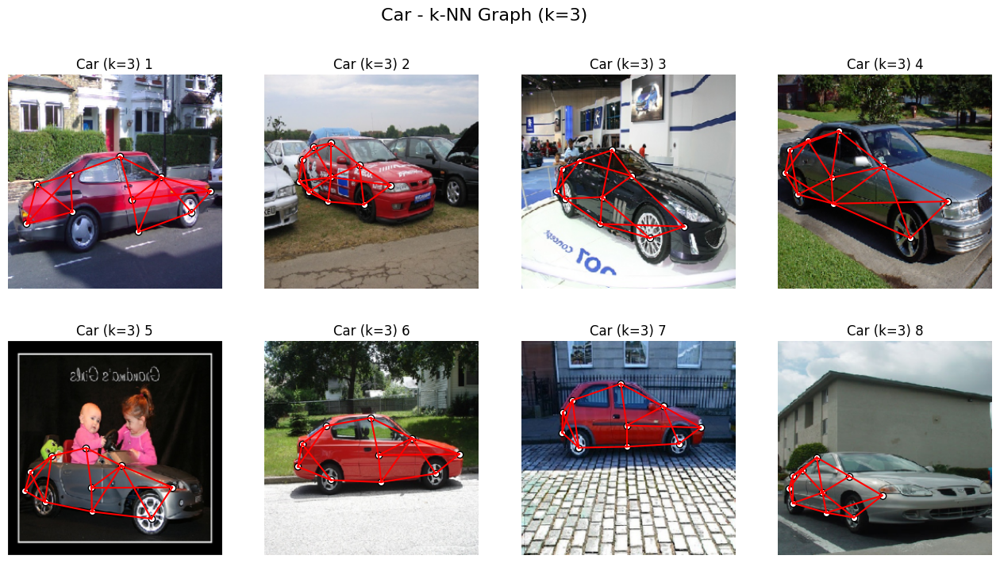

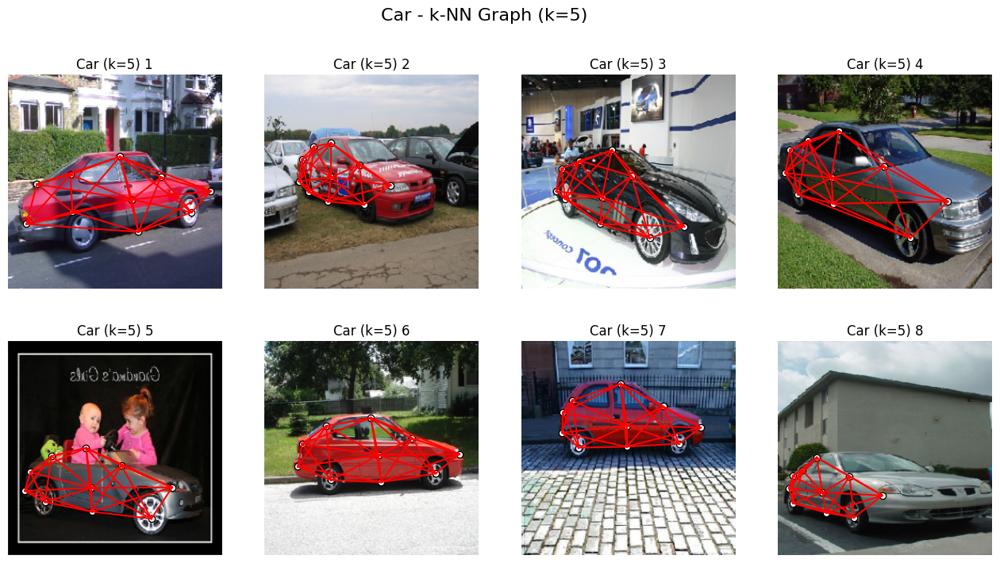

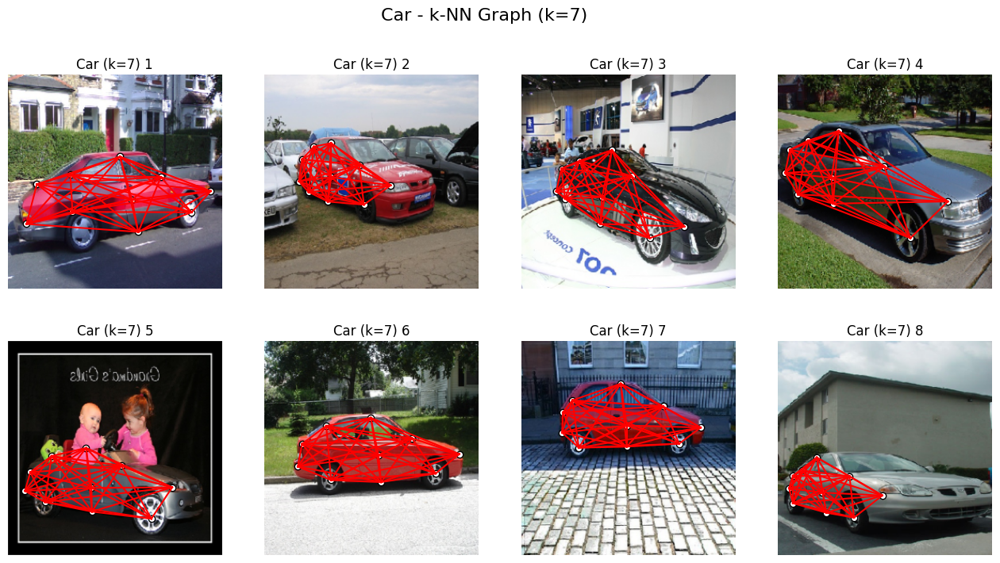

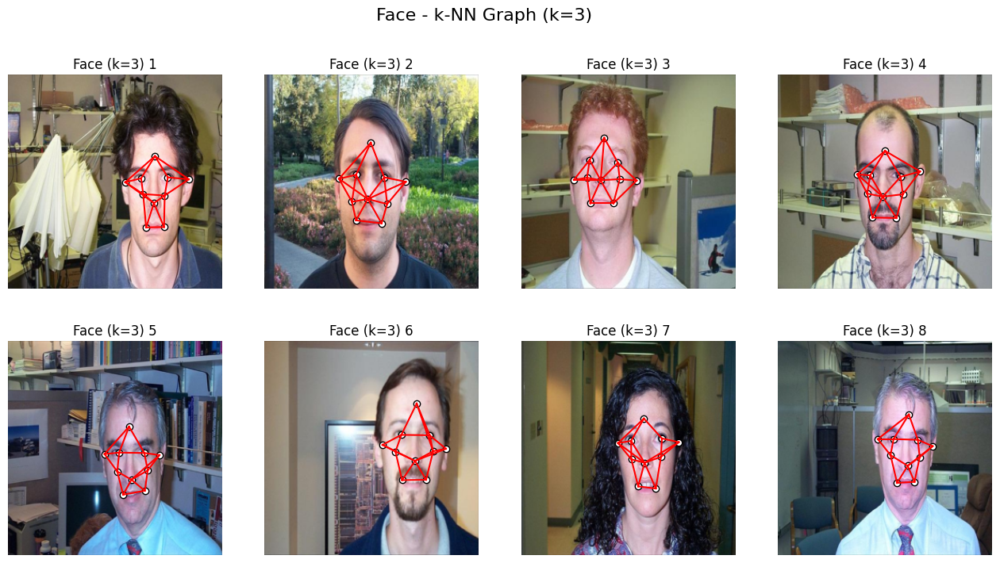

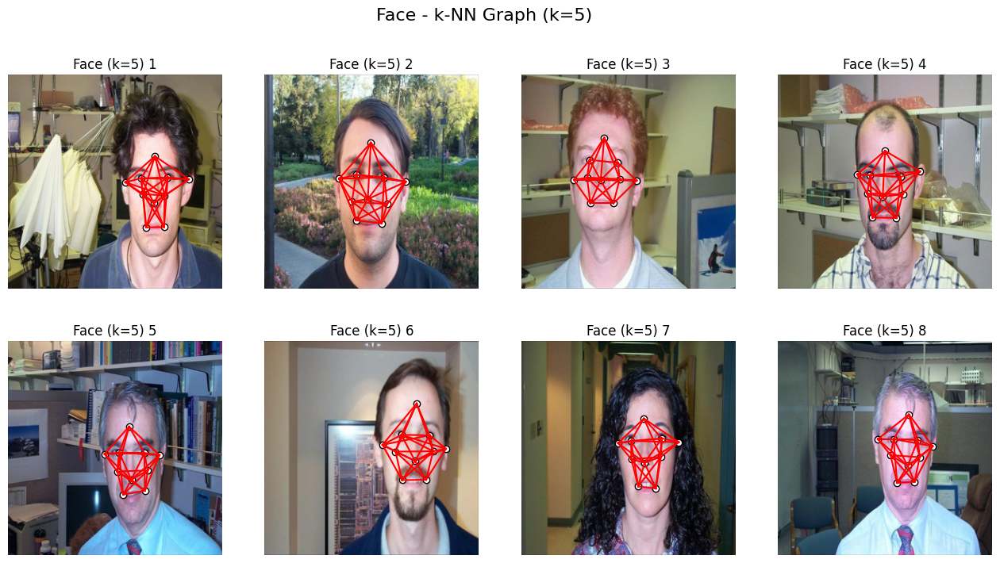

...

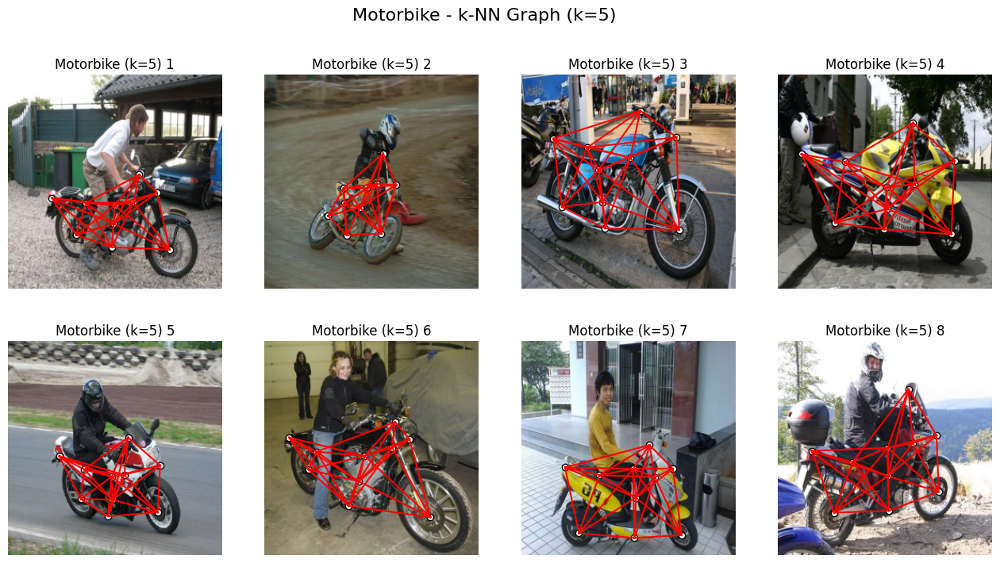

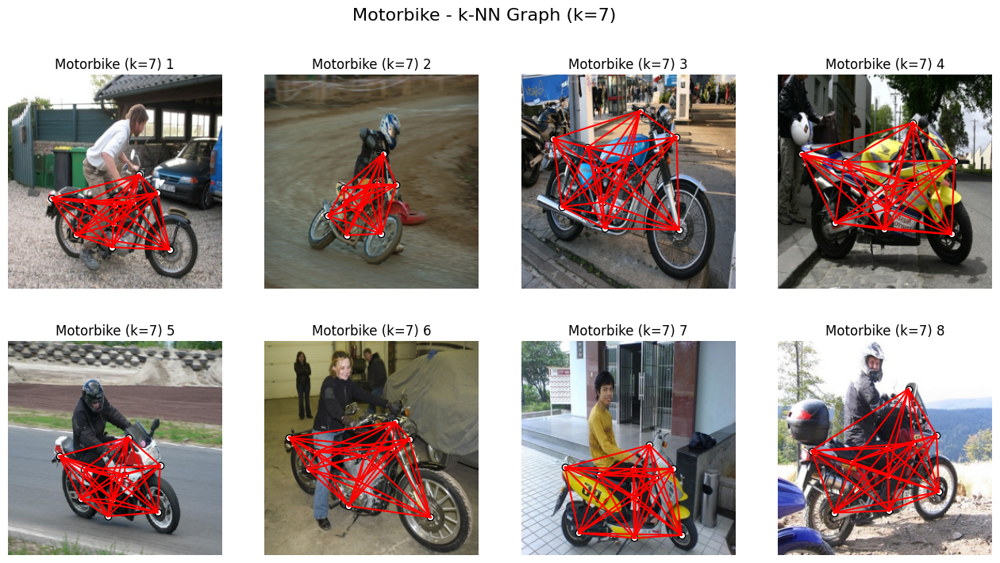

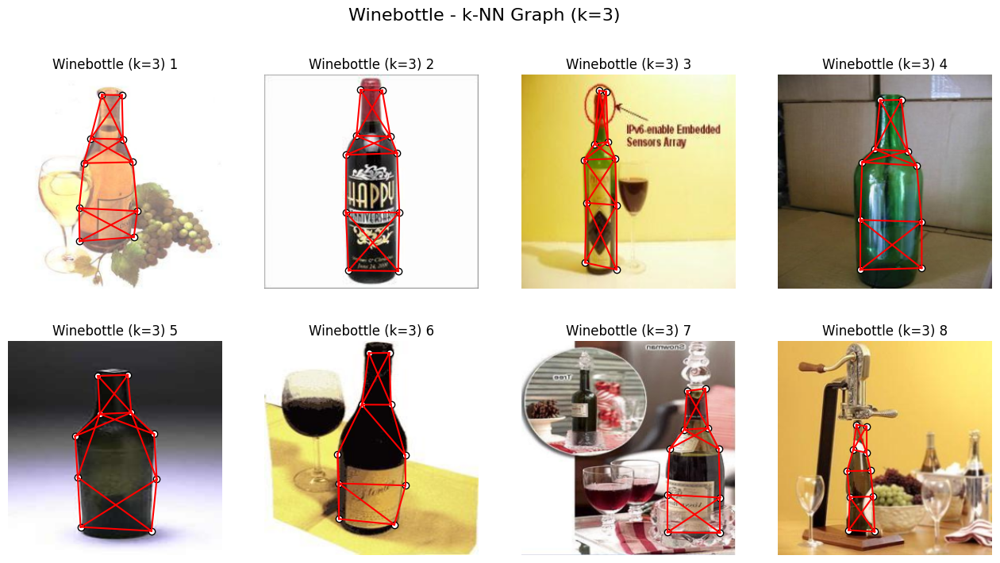

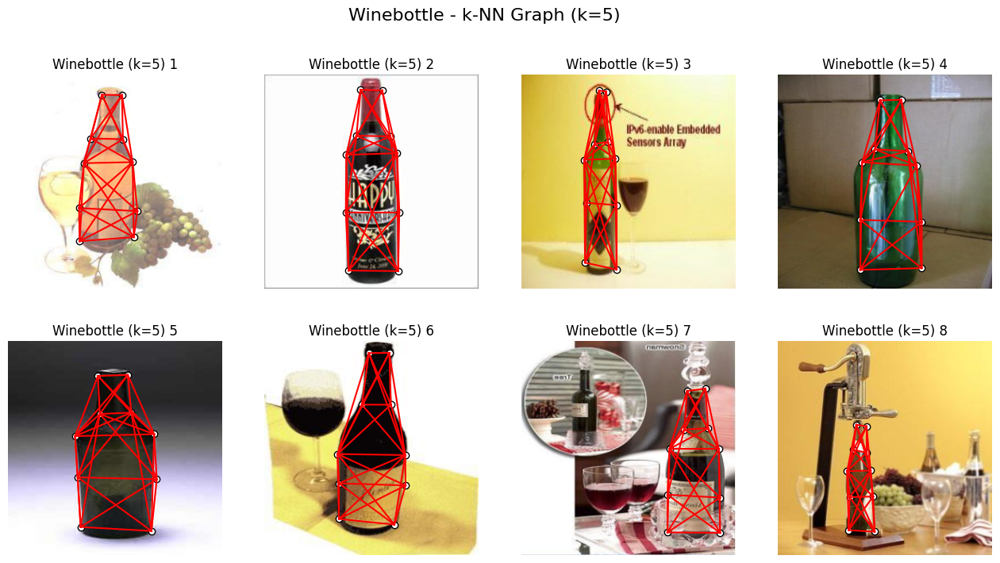

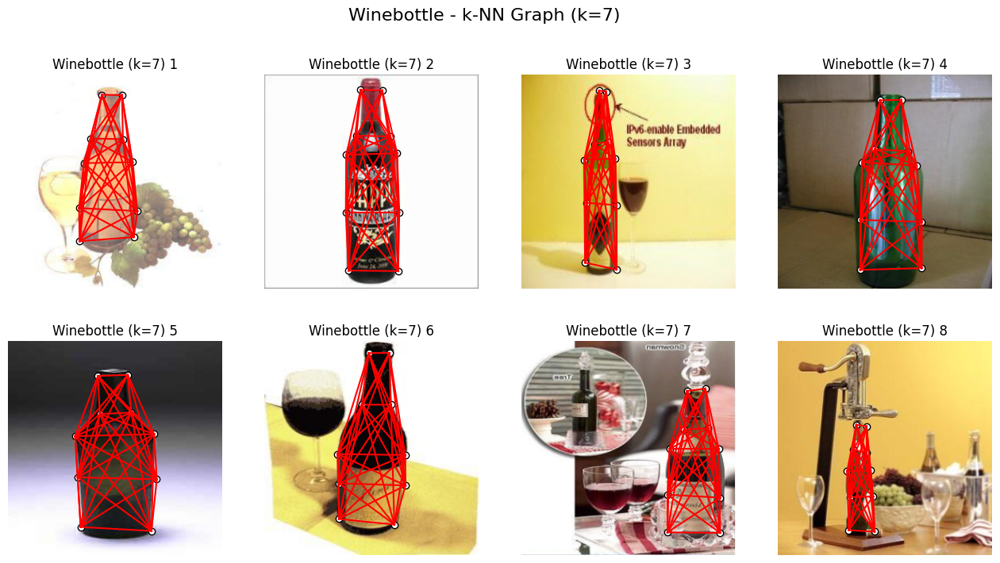

In [9]:
# Ejercicio 2: k-Nearest Neighbors (k-NN)
# Para cada categoría y para cada valor de k (3, 5, 7), se muestra un grid 2x4.

ks = [3, 5, 7]
for cat_name, cat_df in dlf.items():
    
    # Seleccionar 8 imágenes
    sample_rows = cat_df.sample(8)
    
    for k in ks:
        fig, axs = plt.subplots(2, 4, figsize=(16, 8))
        axs = axs.flatten()
        
        for i, (_, row) in enumerate(sample_rows.iterrows()):
            img, kpts = load_img_and_keypoints_from_row(row)
            edges = knn_graph(kpts, k)
            plot_image_with_graph(axs[i], img, kpts, edges, title=f"{cat_name.capitalize()} (k={k}) {i+1}")
        
        
        fig.suptitle(f"{cat_name.capitalize()} - k-NN Graph (k={k})", fontsize=16)
        plt.show()